<a href="https://colab.research.google.com/github/Sarthak132/Machine_Learning_Projects/blob/main/Using_Tranfer_Learning_and_Tensorflow_2_0_to_Classify_Different_Dog_Breeds.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Dog Vision**

Multi-Classification Problem to be able to identify the correct breed of dog among 120 different dog breeds.

1. Get the data ready
2. Prepare the data (preprocessing, 3 sets, X & y)
3. Choose and fit/train a model
4. Evaluating a model
5. Improve the model through experimentation
6. Save, sharing, and reloading your model

We will be using tranfer learning via Tensorflow for this problem.

**Getting our workspace ready**

In [2]:
import tensorflow as tf
print("TF version:", tf.__version__)

TF version: 2.17.0


In [3]:
import tensorflow as tf
import tensorflow_hub as hub

print("TF version:", tf.__version__)
print("Hub version:", hub.__version__)

# Check for GPU
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available:")

TF version: 2.17.0
Hub version: 0.16.1
GPU not available:


**Getting Data rady**

In [4]:
# Running this cdll will provide you with a token to link your drive to this notebook

from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
# Using the '-d' parameter as the destination for where the files should go
# !unzip "drive/My Drive/Data/dog-breed-identification.zip" -d "drive/My Drive/Data"

**Accessing the data**

In [6]:
# Checkout the labels of our data
import pandas as pd
label_csv = pd.read_csv("drive/My Drive/Data/labels.csv")
print(label_csv.describe())
print(label_csv.head())

                                      id               breed
count                              10222               10222
unique                             10222                 120
top     000bec180eb18c7604dcecc8fe0dba07  scottish_deerhound
freq                                   1                 126
                                 id             breed
0  000bec180eb18c7604dcecc8fe0dba07       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97             dingo
2  001cdf01b096e06d78e9e5112d419397          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62  golden_retriever


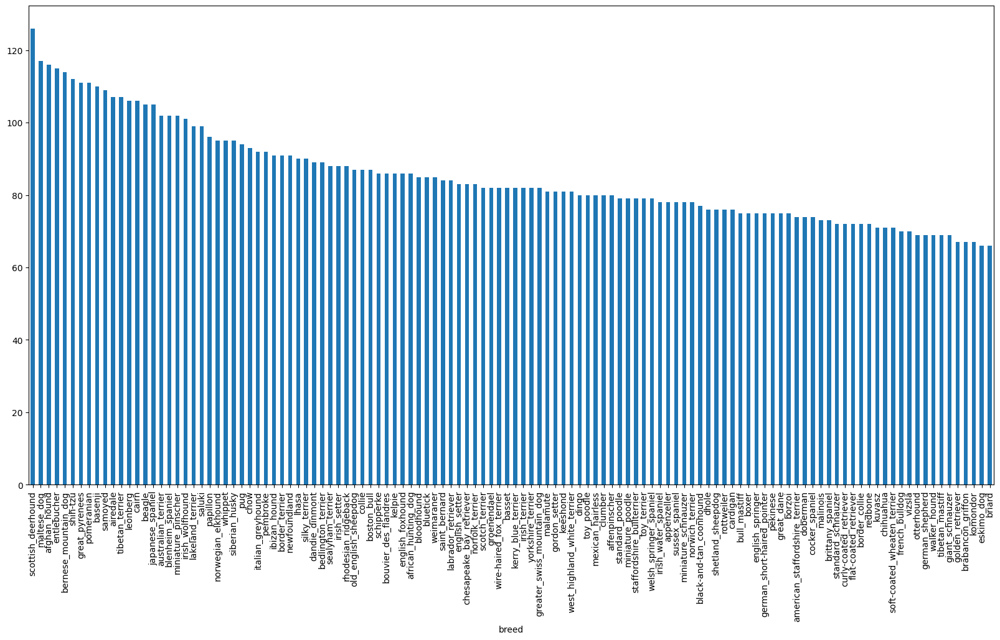

In [7]:
# How many images are there of each breed?
label_csv["breed"].value_counts().plot.bar(figsize=(20, 10));

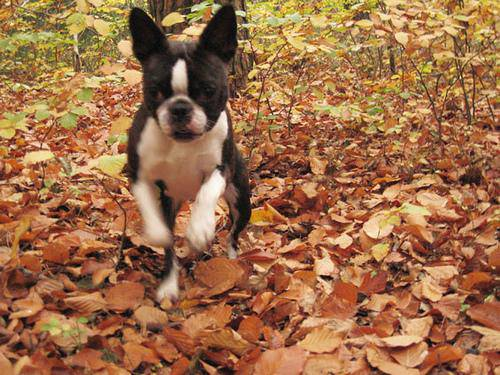

In [8]:
from IPython.display import display, Image
Image("drive/My Drive/Data/train/000bec180eb18c7604dcecc8fe0dba07.jpg")

**Getting images and their labels**

In [9]:
# Create pathnames from umage ID's
filenames = ["drive/My Drive/Data/train/" + fname + ".jpg" for fname in label_csv["id"]]

# Check the first 10 filenames
filenames[:10]

['drive/My Drive/Data/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 'drive/My Drive/Data/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 'drive/My Drive/Data/train/001cdf01b096e06d78e9e5112d419397.jpg',
 'drive/My Drive/Data/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 'drive/My Drive/Data/train/0021f9ceb3235effd7fcde7f7538ed62.jpg',
 'drive/My Drive/Data/train/002211c81b498ef88e1b40b9abf84e1d.jpg',
 'drive/My Drive/Data/train/00290d3e1fdd27226ba27a8ce248ce85.jpg',
 'drive/My Drive/Data/train/002a283a315af96eaea0e28e7163b21b.jpg',
 'drive/My Drive/Data/train/003df8b8a8b05244b1d920bb6cf451f9.jpg',
 'drive/My Drive/Data/train/0042188c895a2f14ef64a918ed9c7b64.jpg']

In [10]:
# Check whether the number of filenames matches number of actual image files
import os
if len(os.listdir("drive/My Drive/Data/train/")) == len(filenames):
  print("Filenames match actual amount of files!")
else:
  print("Filenames do not match actual amount of files, check the target directory.")

Filenames match actual amount of files!


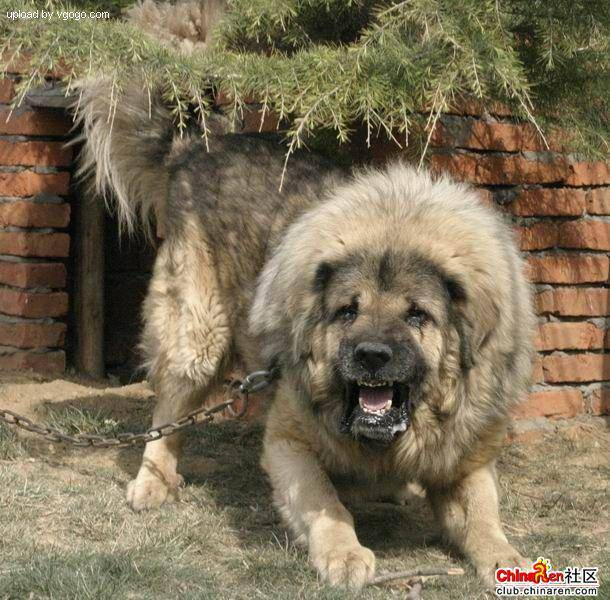

In [11]:
# Check an image directly from a filepath
Image(filenames[9000])

In [12]:
import numpy as np
labels = label_csv["breed"].to_numpy() # convert labels columns to NumPy array
labels[:10]

array(['boston_bull', 'dingo', 'pekinese', 'bluetick', 'golden_retriever',
       'bedlington_terrier', 'bedlington_terrier', 'borzoi', 'basenji',
       'scottish_deerhound'], dtype=object)

In [13]:
# See if number of labelsmatch the number of filenames
if len(labels) == len(filenames):
  print("Number of labels matches number of filenames!")
else:
  print("Number of labels does not match number of filenames, check data directories.")

Number of labels matches number of filenames!


In [14]:
# Find the unique label values
unique_breeds = np.unique(labels)
len(unique_breeds)

120

In [15]:
# Example: Turn one label into an array of booleans
print(labels[0])
labels[0] == unique_breeds # use comparison operator to create boolean array

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [16]:
# Turn every label into a boolean array
boolean_labels = [label == np.array(unique_breeds) for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [17]:
# Example: Turning a boolean array into integers
print(labels[0]) # original label
print(np.where(unique_breeds == labels[0])[0][0]) # index where label occurs
print(boolean_labels[0].argmax()) # Index where labels occurs in boolean array
print(boolean_labels[0].astype(int)) # there will be a 1 where the sample label occurs

boston_bull
19
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


**Creating our own validation set**

In [18]:
# Setup X & y variables
X = filenames
y = boolean_labels

In [19]:
# Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type:"slider", min:1000, max:10000, step:1000}
NUM_IMAGES

1000

In [20]:
# Import train_test_split from Scikit-Learn
from sklearn.model_selection import train_test_split

# Split them into training and validation using NUM_IMAGES
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES],
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42)

len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [21]:
# Check out the training data (image file paths and labels)
X_train[:5], y_train[:2]

(['drive/My Drive/Data/train/00bee065dcec471f26394855c5c2f3de.jpg',
  'drive/My Drive/Data/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  'drive/My Drive/Data/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  'drive/My Drive/Data/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  'drive/My Drive/Data/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         Fa

**Preprocessing images (turning images into Tensors)

* Takes an image filename as input
* Uses TensorFlow to read the file and save it to a variable, image.
* Turn our image (a jpeg file) into Tensors.
* Resize the image to be of shape (224, 224).
* Return the modified image.

In [22]:
# Convert image to NumPy array
from matplotlib.pyplot import imread
image = imread(filenames[42]) # read in an image
image.shape

(257, 350, 3)

In [23]:
tf.constant(image)[:2]

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  89],
        [ 76, 124,  76],
        [ 63, 111,  61],
        ...,
        [ 77, 133,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  75],
        [ 67, 114,  68],
        [ 63, 110,  64],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 132,  84]]], dtype=uint8)>

In [24]:
# Define image size
IMG_SIZE = 224
def process_image(image_path):
  """
  Takes an image file path and turns it into a Tensor.
  """
  # Read in image file
  image = tf.io.read_file(image_path)
  # Turn the jpeg image into numerical Tensor with 3 colour channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  # Convert the color channel values from 0-225 values to 0-1 values
  image = tf.image.convert_image_dtype(image, tf.float32)
  # Resize the image to our desired size (224, 224)
  image = tf.image.resize(image, size=[IMG_SIZE, IMG_SIZE])
  return image

**Creating data batches**

In [25]:
# Create a simple function to return a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes an image file path name and the associated label,
  processes the image and returns a tupe of (image, label).
  """
  image = process_image(image_path)
  return image, label

In [26]:
# Define the batch size, 32 is a good default
BATCH_SIZE = 32

# Create a function to turn data into batches
def create_data_batches(x, y=None, batch_size=BATCH_SIZE, valid_data=False, test_data=False):
  """
  Creates batches of data out of image (x) and label (y) pairs.
  Shuffles the data if it's training data but doesn't shuffle it if it's validation data.
  Also accepts test data as input (no labels).
  """
  # If the data is a test dataset, we probably don't have labels
  if test_data:
    print("Creating test data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x))) # only filepaths
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch

  # If the data is a valid dataset, we don't need to shuffle it
  elif valid_data:
    print("Creating validation data batches...")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepaths
                                               tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE)
    return data_batch

  else:
    # If the data is a training dataset, we shuffle it
    print("Creating training data batches...")
    # Turn filepaths and labels into Tensors
    data = tf.data.Dataset.from_tensor_slices((tf.constant(x), # filepahts
                                               tf.constant(y))) # labels

    # Shuffling pathnames and labels before mapping image processor function is faster than shuffling images
    data = data.shuffle(buffer_size=len(x))

    # Create (image, label) tuples (this also turns the image path into a preprocessed image)
    data = data.map(get_image_label)

    # Turn the data into batches
    data_batch = data.batch(BATCH_SIZE)
  return data_batch



In [27]:
# Create training and validation data batches
train_data = create_data_batches(X_train, y_train)
val_data = create_data_batches(X_val, y_val, valid_data=True)

Creating training data batches...
Creating validation data batches...


In [28]:
# Check put the different attributes of our data batches
train_data.element_spec, val_data.element_spec

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

**Visualizing data batches**

In [29]:
import matplotlib.pyplot as plt

# Create a function for viewing images in a data batch
def show_25_images(images, labels):
  """
  Displays 25 images from a data batch.
  """
  # Setup the figure
  plt.figure(figsize=(10, 10))
  # Loop through 25 (for displaying 25 images)
  for i in range(25):
    # Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5, 5, i+1)
    # Display an image
    plt.imshow(images[i])
    # Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()])
    # Turn grid lines off
    plt.axis("off")

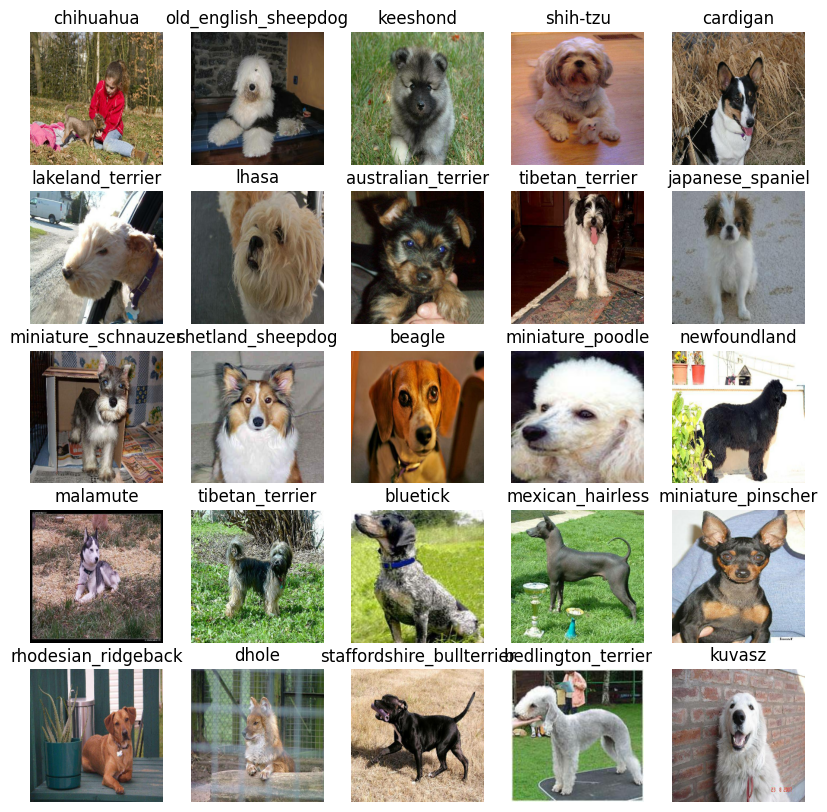

In [30]:
# Visualize training images from the training data batch
train_images, train_labels = next(train_data.as_numpy_iterator())
show_25_images(train_images, train_labels)

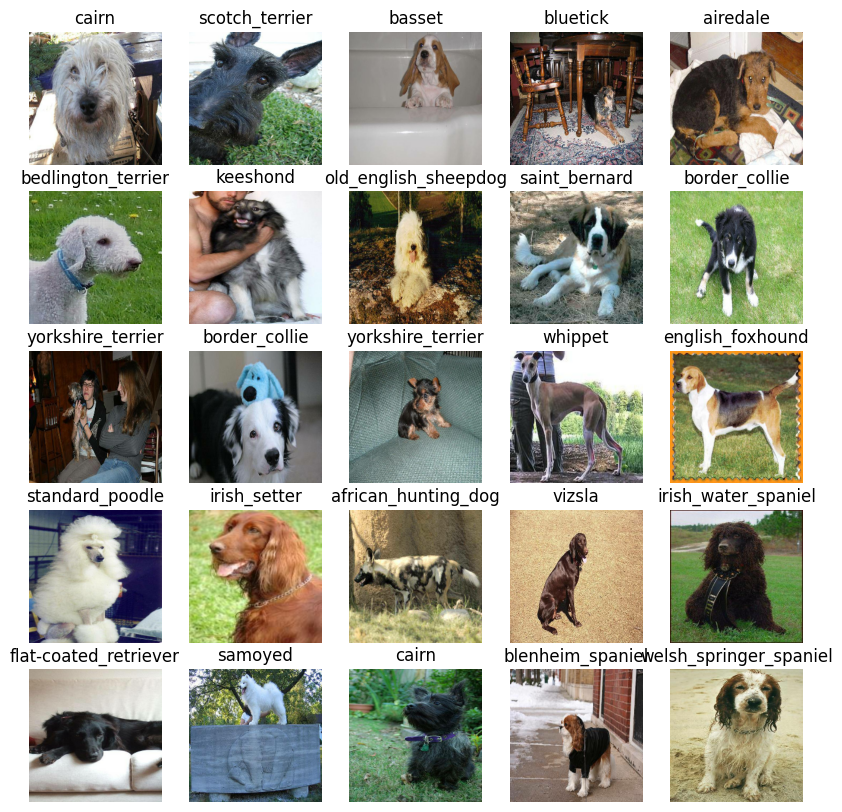

In [31]:
# Visualize validation images from the validation data batch
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

**Creating and training a model**

**Building a model**

In [32]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMG_SIZE, IMG_SIZE, 3] # batch, height, width, colour channels

# Setup output shape of the model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels

# Setup model URL from TensorFlow Hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

In [33]:
import tf_keras

def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
    print("Building model with:", model_url)

    # Setup the model layers
    model = tf_keras.Sequential([
            hub.KerasLayer(model_url),  # Layer 1 (input layer)
            tf_keras.layers.Dense(units=output_shape, activation="softmax")  # Layer 2 (output layer)
    ])

    # Compile the model
    model.compile(
        loss=tf_keras.losses.CategoricalCrossentropy(),  # Our model wants to reduce this (how wrong its guesses are)
        optimizer=tf_keras.optimizers.Adam(),  # A friend telling our model how to improve its guesses
        metrics=["accuracy"]  # We'd like this to go up
    )

    # Build the model
    model.build(input_shape)

    return model

In [34]:
# Create a model and check its details
model = create_model()
model.summary()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 keras_layer (KerasLayer)    (None, 1001)              5432713   
                                                                 
 dense (Dense)               (None, 120)               120240    
                                                                 
Total params: 5552953 (21.18 MB)
Trainable params: 120240 (469.69 KB)
Non-trainable params: 5432713 (20.72 MB)
_________________________________________________________________


**Creating callbacks**

**TensorBoard Callback**

In [35]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [36]:
import datetime
import os

# Create a function to build a TensorBoard callback
def create_tensorboard_callback():
  # Create a log directory for storing TensorBoard logs
  logdir = os.path.join("drive/My Drive/Data/logs",
                        # Make it so the logs get tracked whenever we run an experiment
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
  return tf_keras.callbacks.TensorBoard(log_dir=logdir)

**Early Stopping Callback**

In [37]:
# Create early stopping (once our model stops improving, stop training)
early_stopping = tf_keras.callbacks.EarlyStopping(monitor="val_accuracy",
                                                  patience=3) # stops after 3 rounds of no improvements

**Training a model (on a subset of data)**

In [38]:
# Check again if GPU is available (otherwise computing wile take a looooooonnngggg time)
print("GPU", "available (YESS!!!!)" if tf.config.list_physical_devices("GPU") else "not available.")

GPU not available.


In [39]:
# How many rounds should we get the model to look through the data?
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

In [40]:
# Build a dunction to train and return a trained model
def train_model():
  """
  Trains a given model and returns the trained version.
  """
  # Create a model
  model = create_model()

  # Create new TensorBoard session everytime we train a model
  tensorboard = create_tensorboard_callback()

  # Fit the model to the training data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,
            validation_freq=1, # check the validation metrics every epoch
            callbacks=[tensorboard, early_stopping])

  return model

In [41]:
# Fit the model to the data
model = train_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4
Epoch 1/100
25/25 [==============================] - 329s 11s/step - loss: 4.5919 - accuracy: 0.1013 - val_loss: 3.3938 - val_accuracy: 0.2700
Epoch 2/100
25/25 [==============================] - 60s 2s/step - loss: 1.6493 - accuracy: 0.6837 - val_loss: 2.2073 - val_accuracy: 0.4700
Epoch 3/100
25/25 [==============================] - 58s 2s/step - loss: 0.5733 - accuracy: 0.9325 - val_loss: 1.7116 - val_accuracy: 0.5650
Epoch 4/100
25/25 [==============================] - 66s 3s/step - loss: 0.2600 - accuracy: 0.9850 - val_loss: 1.5067 - val_accuracy: 0.6150
Epoch 5/100
25/25 [==============================] - 66s 3s/step - loss: 0.1537 - accuracy: 0.9962 - val_loss: 1.4597 - val_accuracy: 0.6250
Epoch 6/100
25/25 [==============================] - 55s 2s/step - loss: 0.1032 - accuracy: 1.0000 - val_loss: 1.4084 - val_accuracy: 0.6350
Epoch 7/100
25/25 [==============================] - 57s 2s

**Checking the TensorBoard logs**

In [42]:
%tensorboard --logdir drive/My\ Drive/Data/logs

<IPython.core.display.Javascript object>

**Making and evaluating predictions using a trained model**

In [43]:
# # Make predictions on the validation data (not used to train on)
predictions = model.predict(val_data, verbose=1) # verbose shows us how long there is to go
predictions

7/7 [==============================] - 23s 2s/step


array([[3.03831242e-04, 1.03163402e-04, 6.86584623e-04, ...,
        1.10321256e-04, 1.13948568e-04, 1.34587416e-03],
       [1.87293137e-03, 6.44340471e-04, 1.02725364e-02, ...,
        3.37675127e-04, 5.44817187e-04, 1.05973879e-04],
       [7.79035781e-06, 5.91630014e-05, 1.34737475e-05, ...,
        1.62646902e-05, 3.01485761e-06, 4.88168080e-05],
       ...,
       [8.09639096e-06, 9.26774665e-05, 7.88690959e-05, ...,
        7.11478569e-05, 6.38538157e-04, 2.22347764e-04],
       [2.53669010e-03, 3.47975089e-04, 5.55663173e-05, ...,
        9.11936440e-05, 5.88871844e-05, 2.60247011e-03],
       [3.03846342e-03, 2.63242237e-05, 3.41200968e-03, ...,
        1.21950288e-03, 1.39320153e-03, 4.83409036e-04]], dtype=float32)

In [44]:
# # Check the shape of predictions
predictions.shape

(200, 120)

In [45]:
# # First prediction
print(predictions[0])
print(f"Max value (probability of prediction): {np.max(predictions[0])}") # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}") # because we used softmax activation in our model, this will close to 1
print(f"Max index: {np.argmax(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label

[3.03831242e-04 1.03163402e-04 6.86584623e-04 8.21209687e-05
 3.56560602e-04 4.30512337e-05 1.31513057e-02 7.02925201e-04
 2.56964297e-04 6.48140558e-04 2.71957018e-04 1.20731140e-03
 5.39261455e-05 5.46347583e-05 3.47153487e-04 3.58786841e-04
 1.21463272e-04 1.68866649e-01 7.90569538e-05 1.69353116e-05
 3.78537748e-04 5.92496726e-05 2.29824545e-05 2.50430102e-03
 1.43458965e-04 1.80106275e-04 3.09262186e-01 7.20335374e-05
 1.07655604e-03 1.27417574e-04 7.26586295e-05 5.06836455e-04
 1.03333266e-03 1.86529942e-04 1.02965350e-04 5.52676572e-03
 4.17640695e-05 2.61867972e-04 3.32448362e-05 5.14493258e-05
 1.99662661e-03 1.13677916e-05 2.98793631e-04 1.31834868e-05
 8.50730939e-05 2.16805682e-04 7.63281569e-05 5.29705663e-04
 9.98577016e-05 8.61969951e-04 1.87783182e-04 2.39790068e-04
 2.19103109e-04 5.81623928e-04 6.13972661e-04 1.84297278e-05
 3.23735556e-04 2.62401579e-03 8.83849920e-04 1.12869568e-01
 4.10958222e-04 1.11643618e-04 7.67129881e-04 8.01190617e-06
 4.97212750e-04 3.624806

In [46]:
# Turn prediction probabilities(confidence levels) into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[0])
pred_label

'cairn'

In [47]:
# Create a function to unbatch a batched dataset
def unbatchify(data):
  """
  Takes a batched dataset of (image, label) Tensors and returns separate arrays of images and labels.
  """
  images = []
  labels = []
  # Loops through unbatched data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(unique_breeds[np.argmax(label)])
  return images, labels

# Unbatchify the validation data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_images[0]

(array([[[0.29599646, 0.43284872, 0.3056691 ],
         [0.26635826, 0.32996926, 0.22846507],
         [0.31428418, 0.27701408, 0.22934894],
         ...,
         [0.77614343, 0.82320225, 0.8101595 ],
         [0.81291157, 0.8285351 , 0.8406944 ],
         [0.8209297 , 0.8263737 , 0.8423668 ]],
 
        [[0.2344871 , 0.31603682, 0.19543913],
         [0.3414841 , 0.36560842, 0.27241898],
         [0.45016077, 0.40117094, 0.33964607],
         ...,
         [0.7663987 , 0.8134138 , 0.81350833],
         [0.7304248 , 0.75012016, 0.76590735],
         [0.74518913, 0.76002574, 0.7830809 ]],
 
        [[0.30157745, 0.3082587 , 0.21018331],
         [0.2905954 , 0.27066195, 0.18401104],
         [0.4138316 , 0.36170745, 0.2964005 ],
         ...,
         [0.79871625, 0.8418535 , 0.8606443 ],
         [0.7957738 , 0.82859945, 0.8605655 ],
         [0.75181633, 0.77904975, 0.8155256 ]],
 
        ...,
 
        [[0.9746779 , 0.9878955 , 0.9342279 ],
         [0.99153054, 0.99772066, 0.94278

In [48]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth label and image for sample n.
  """
  pred_prob, true_label, image = prediction_probabilities[n], labels[n], images[n]

  # Get the pred label
  pred_label = get_pred_label(pred_prob)

  # Plot image & remove ticks
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])

  # Change the color of the title depending on if the prediction is right or wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"

  plt.title("{} {:2.0f}% ({})".format(pred_label,
                                          np.max(pred_prob)*100,
                                          true_label),
                                          color=color)

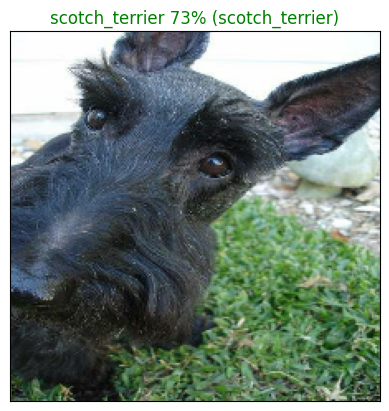

In [49]:
# View an example prediction, original image and truth label
plot_pred(prediction_probabilities=predictions,
          labels=val_labels,
          images=val_images)

In [50]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plots the top 10 highest prediction confidences along with
  the truth label for sample n.
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  # Get the predicted label
  pred_label = get_pred_label(pred_prob)

  # Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]
  # Find the tio 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]
  # Find the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  # Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
             labels=top_10_pred_labels,
             rotation="vertical")

  # Change color of true label
  if np.isin(true_label, top_10_pred_labels):
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

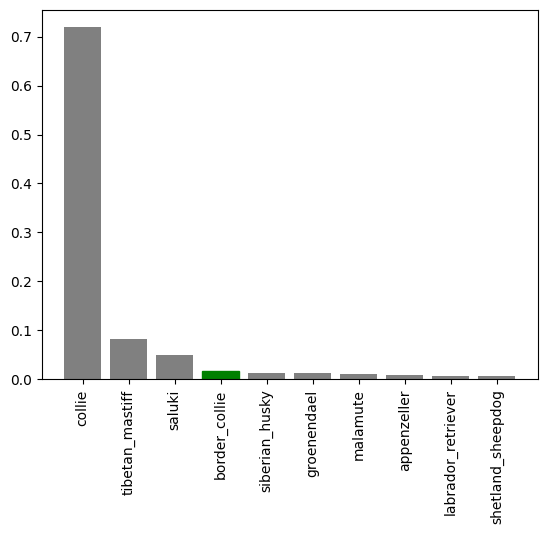

In [51]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=9)

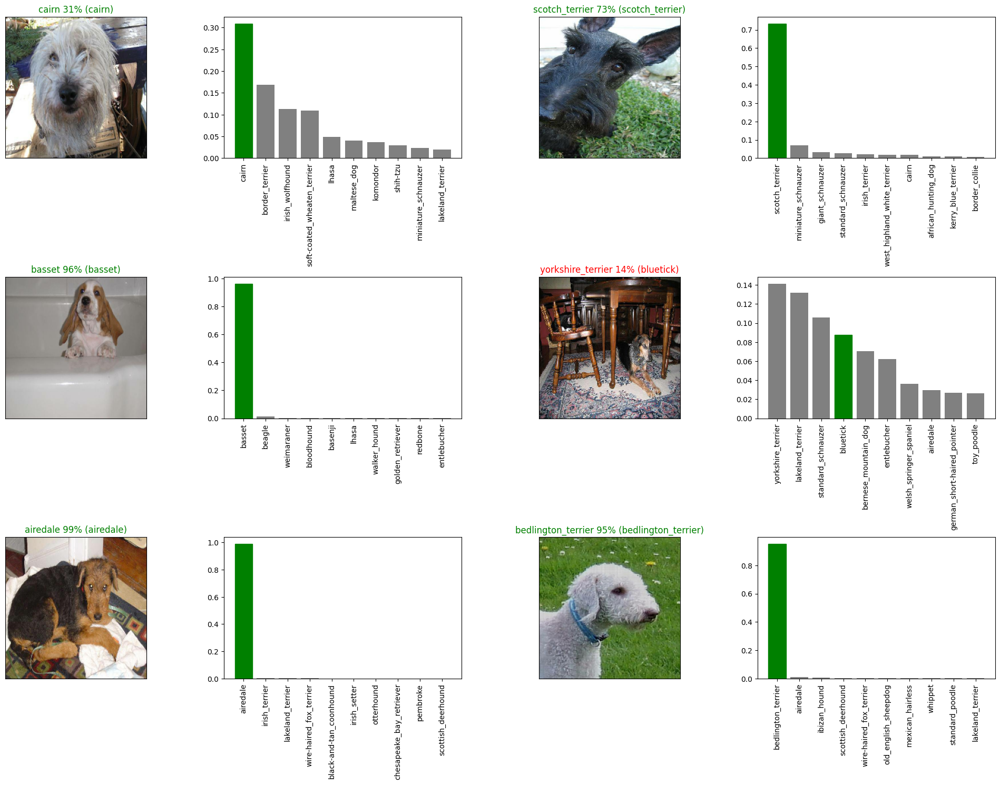

In [52]:
# Let's check a few predictions and their different values
i_multiplier = 0
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(5*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                 labels=val_labels,
                 n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show()

**Saving and reloading a model**

In [53]:
def save_model(model, suffix=None):
  """
  Saves a given model in a models directory and appends a suffix (str)
  for clarity and reuse.
  """
  # Create model directory with current time
  modeldir = os.path.join("drive/My Drive/Data/models",
                          datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" # save format of model
  print(f"Saving model to: {model_path}...")
  model.save(model_path)
  return model_path

In [54]:
def load_model(model_path):
  """
  Loads a saved model from a specified path.
  """
  print(f"Loading saved model from: {model_path}")
  model = tf_keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model

In [55]:
# Save our model trained in 1000 images
save_model(model, suffix="1000-images-Adam")

Saving model to: drive/My Drive/Data/models/20240826-11561724673413-1000-images-Adam.h5...


/usr/local/lib/python3.10/dist-packages/tf_keras/src/engine/training.py:3098: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native TF-Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


'drive/My Drive/Data/models/20240826-11561724673413-1000-images-Adam.h5'

In [56]:
# Load our model trained on 100 images
model_1000_images = load_model('drive/MyDrive/Data/models/20240824-16401724517629-1000-images-Adam.h5')

Loading saved model from: drive/MyDrive/Data/models/20240824-16401724517629-1000-images-Adam.h5


In [57]:
# Evaluate the pre-trained model
model.evaluate(val_data)

7/7 [==============================] - 10s 1s/step - loss: 1.3274 - accuracy: 0.6350


[1.327406406402588, 0.6349999904632568]

In [58]:
# Evaluate the loaded model
model_1000_images.evaluate(val_data)

7/7 [==============================] - 13s 2s/step - loss: 1.3070 - accuracy: 0.6800


[1.3070422410964966, 0.6800000071525574]

**Training a model (on the full data)**

In [59]:
# Remind ourselves of the size of the full dataset
len(X), len(y)

(10222, 10222)

In [60]:
# Turn full training data in a data batch
full_data = create_data_batches(X, y)

Creating training data batches...


In [61]:
# Instantiate a new model for training on the full dataset
full_model = create_model()

Building model with: https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [62]:
# Create full model callbacks

# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accuracy
full_model_early_stopping = tf_keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

In [63]:
%tensorboard --logdir drive/My\ Drive/Data/logs

Reusing TensorBoard on port 6006 (pid 7235), started 0:01:08 ago. (Use '!kill 7235' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# Fit the full model to the full training data
full_model.fit(x=full_data,
                epochs=NUM_EPOCHS,
                callbacks=[full_model_tensorboard,
                           full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 604s 2s/step - loss: 1.3259 - accuracy: 0.6688
Epoch 2/100
320/320 [==============================] - 584s 2s/step - loss: 0.3963 - accuracy: 0.8841
Epoch 3/100
320/320 [==============================] - 585s 2s/step - loss: 0.2353 - accuracy: 0.9371
Epoch 4/100
320/320 [==============================] - 579s 2s/step - loss: 0.1538 - accuracy: 0.9629
Epoch 5/100
320/320 [==============================] - 580s 2s/step - loss: 0.1050 - accuracy: 0.9772
Epoch 6/100
320/320 [==============================] - 568s 2s/step - loss: 0.0792 - accuracy: 0.9860
Epoch 7/100
320/320 [==============================] - 584s 2s/step - loss: 0.0579 - accuracy: 0.9919
Epoch 8/100
320/320 [==============================] - 611s 2s/step - loss: 0.0455 - accuracy: 0.9945
Epoch 9/100
320/320 [==============================] - 578s 2s/step - loss: 0.0379 - accuracy: 0.9964
Epoch 10/100
320/320 [==============================] - 588s 2s/step - loss: 0.031

**Saving and reloading the full model**

In [ ]:
# Save model to file
save_model(full_model, suffix="all-images-Adam")

In [ ]:
import tf_keras
# Load in the full model
loaded_full_model = load_model('drive/My Drive/Data/models/20240825-10221724581336-all-images-Adam.h5')

**Making predictions on the test dataset**

In [ ]:
# Load test image filenames (since we're using os.listdir(), these already have .jpg)
import os
test_path = "drive/My Drive/Data/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

test_filenames[:10]

In [ ]:
# How many test images are there?
len(test_filenames)

In [ ]:
# Create test data batch
test_data = create_test_batches(test_filenames, test_data=True)

In [ ]:
# Make predictions on test data batch using the loaded full model
test_predictions = loaded_full_model.predict(test_data,
                                              verbose=1)

In [ ]:
# Check out the test predictions
test_predictions[:10]

**Preparing test dataset predictions for Kaggle**

In [ ]:
# Create pandas DataFrame with empty columns
preds_df = pd.DataFrame(columns=["id"] + list(unique_breeds))
preds_df.head()

In [ ]:
# Append test image ID's to predictions DataFrame
test_path = "drive/My Drive/Data/test/"
preds_df["id"] = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
preds_df.head()

In [ ]:
# Add the predictions probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
pred_df.head()

In [ ]:
preds_df.to_csv("drive/My Drive/Data/full_submission_1_mobilienetV2_adam.csv",
                index=False)

**Making predictions on custom images**

In [ ]:
# Get custom image filepaths
custom_path = "drive/My Drive/Data/Dogs/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)
                        if os.path.isfile(os.path.join(custom_path, fname))]

In [ ]:
custom_image_paths

In [ ]:
# Turn custom image into batch (set to test data because there are no labels)
custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

In [ ]:
# Make predictions on the custom data
custom_preds = loaded_full_model.predict(custom_data)
len(custom_preds)

In [ ]:
# Get custom image prediction labels
custom_pred_labels = [get_pred_label(custom_preds[i]) for i in range(len(custom_preds))]
custom_pred_labels

In [ ]:
# Get custom images (out unbatchify() function won't work since there aren't labels)
custom_images = []
# Loop through unbatched data
for image in custom_data.unbatch().as_numpy_iterator():
  custom_images.append(image)

In [ ]:
# Check custom image predictions
plt.figure(figsize=(10, 10))
for i, image in enumerate(custom_images):
  plt.subplot(1, 4, i+1)
  plt.xticks([])
  plt.yticks([])
  plt.title(custom_pred_labels[i])
  plt.imshow(image)